In [1]:
!pip install ultralytics

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 898.5/898.5 kB 14.5 MB/s eta 0:00:00a 0:00:01


In [2]:
!pip install albumentations

In [3]:
import numpy as np
import pandas as pd
import warnings
import matplotlib.pyplot as plt
from IPython.core.magic import register_line_cell_magic
import yaml
from PIL import Image
import os
import seaborn as sns
from ultralytics import YOLO
from matplotlib.patches import Rectangle
import glob
import cv2

os.environ['CUDA_LAUNCH_BLOCKING'] = '1'

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [4]:
!pip install --upgrade ray

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.3/66.3 MB 20.3 MB/s eta 0:00:0000:0100:01
  Attempting uninstall: ray
    Found existing installation: ray 2.4.0
    Uninstalling ray-2.4.0:
      Successfully uninstalled ray-2.4.0


## Load dataset

In [5]:
import os
import random
import shutil

# Set up source and destination paths
source_folder = '/kaggle/input/vehicle-detection-8-classes-object-detection/train'
train_folder = '/kaggle/working/traindata'
test_folder = '/kaggle/working/testdata'
valid_folder = '/kaggle/working/validdata'

# Create destination folders
for folder in [train_folder, test_folder, valid_folder]:
    os.makedirs(os.path.join(folder, 'images'), exist_ok=True)
    os.makedirs(os.path.join(folder, 'labels'), exist_ok=True)

# Get list of image files
image_files = [filename for filename in os.listdir(os.path.join(source_folder, 'images')) if filename.endswith('.jpg')]

# Randomize the order of the image files
random.shuffle(image_files)

# Determine split sizes
train_size = int(0.8 * len(image_files))
test_size = int(0.15 * len(image_files))
valid_size = len(image_files) - train_size - test_size

# Copy images and labels to the destination folders
for i, filename in enumerate(image_files):
    image_path = os.path.join(source_folder, 'images', filename)
    label_path = os.path.join(source_folder, 'labels', filename.replace('.jpg', '.txt'))
    if not os.path.exists(label_path):
        continue

    # Read label file (without filtering or renaming classes)
    with open(label_path, 'r') as file:
        lines = file.readlines()

    # Determine destination folder based on split
    if i < train_size:
        destination_folder = train_folder
    elif i < train_size + test_size:
        destination_folder = test_folder
    else:
        destination_folder = valid_folder

    # Copy image and labels to the destination folder
    shutil.copy(image_path, os.path.join(destination_folder, 'images', filename))
    with open(os.path.join(destination_folder, 'labels', filename.replace('.jpg', '.txt')), 'w') as file:
        file.writelines(lines)

print("Dataset split and file copy completed!")

Dataset split and file copy completed!


In [6]:
import os

# Original classes and renaming map
CLASSES = ['Motorcycle', 'Car', 'Bus', 'Truck']

# Path to the folders containing annotation TXT files
folders = ['/kaggle/working/testdata/labels', 
           '/kaggle/working/traindata/labels', 
           '/kaggle/working/validdata/labels']

# Define the renaming map for class IDs
class_rename_map = {
    0: 0,  # Motorcycle → 0
    1: 1,  # Auto → 1
    2: 1,  # Car → 1
    3: 2,  # Bus → 2
    4: 0,  # LCV → 0
    5: 3,  # Truck → 3
    6: 3,  # Tractor → 3
    7: 3   # Multi-Axle → 3
}

# Process each annotation file in the specified folders
for folder in folders:
    print(f"Processing folder: {folder}")
    for filename in os.listdir(folder):
        if filename.endswith(".txt"):
            annotation_file = os.path.join(folder, filename)
            print(f"Processing file: {filename}")

            with open(annotation_file, "r") as file:
                lines = file.readlines()
            
            updated_lines = []
            for line in lines:
                parts = line.strip().split()
                old_class_id = int(parts[0])
                
                # Skip lines with ignored class IDs
                if old_class_id not in class_rename_map:
                    print(f"Skipping class {old_class_id} (no mapping found)")
                    continue
                
                # Update the class ID based on the renaming map
                new_class_id = class_rename_map[old_class_id]
                print(f"Renaming class {old_class_id} to new class {new_class_id}")
                parts[0] = str(new_class_id)
                updated_lines.append(" ".join(parts))
            
            # If there are any updated lines, rewrite the file
            if updated_lines:
                with open(annotation_file, "w") as file:
                    file.write("\n".join(updated_lines))
                print(f"File {filename} updated with new class IDs.")
            else:
                # If no valid class left after renaming, remove the file
                os.remove(annotation_file)
                print(f"File {filename} removed (no valid classes left after renaming).")

print("Class renaming completed!")


Processing folder: /kaggle/working/testdata/labels
Processing file: Highway_1107_2020-07-30_jpg.rf.9c940e43e05c8b4113bac6336004a12f.txt
Renaming class 2 to new class 1
Renaming class 2 to new class 1
Renaming class 4 to new class 0
File Highway_1107_2020-07-30_jpg.rf.9c940e43e05c8b4113bac6336004a12f.txt updated with new class IDs.
Processing file: highway_2530_2020-08-26.txt
Renaming class 2 to new class 1
Renaming class 1 to new class 1
Renaming class 4 to new class 0
Renaming class 4 to new class 0
Renaming class 4 to new class 0
File highway_2530_2020-08-26.txt updated with new class IDs.
Processing file: ulu2075_jpg.rf.eef93883a0fc1c93b7799fdee99a8047.txt
Renaming class 7 to new class 3
Renaming class 4 to new class 0
Renaming class 4 to new class 0
Renaming class 4 to new class 0
File ulu2075_jpg.rf.eef93883a0fc1c93b7799fdee99a8047.txt updated with new class IDs.
Processing file: Highway_571_2020-07-30_jpg.rf.ea4802f635ea378502d9bd2f2e7ae19e.txt
Renaming class 7 to new class 3
Fil

## Display images and labels

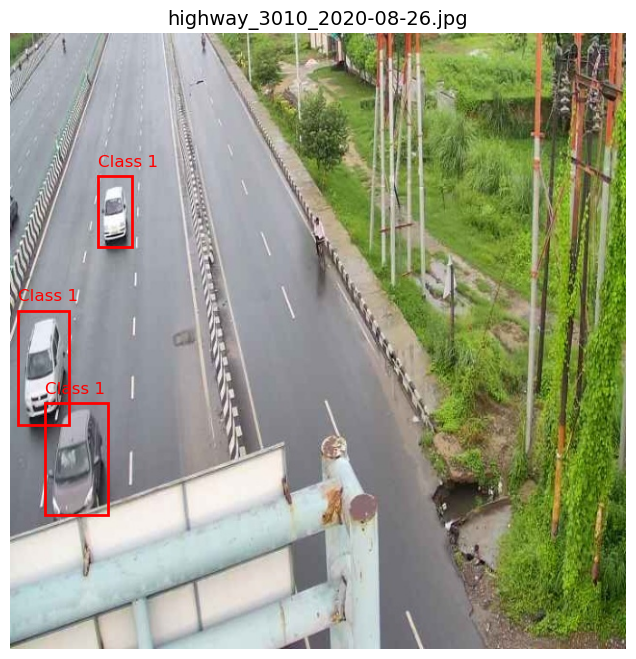

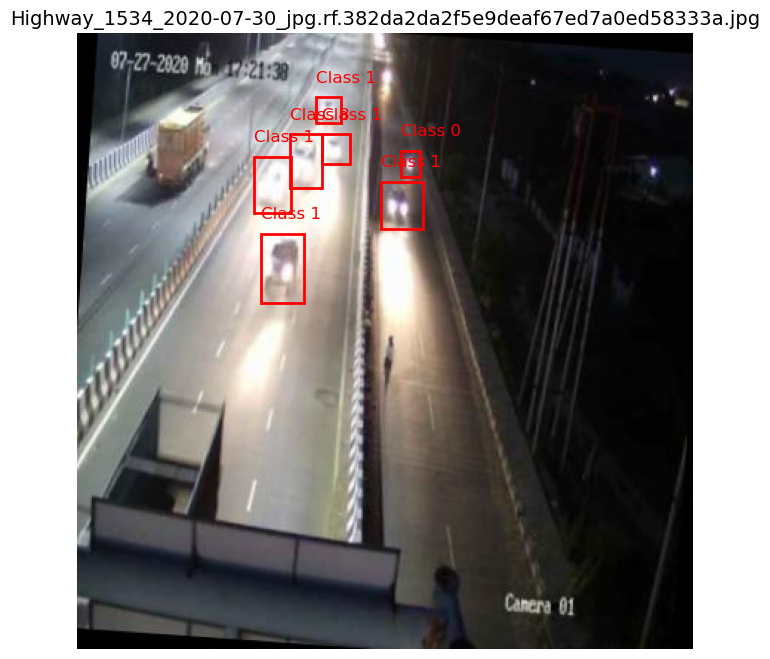

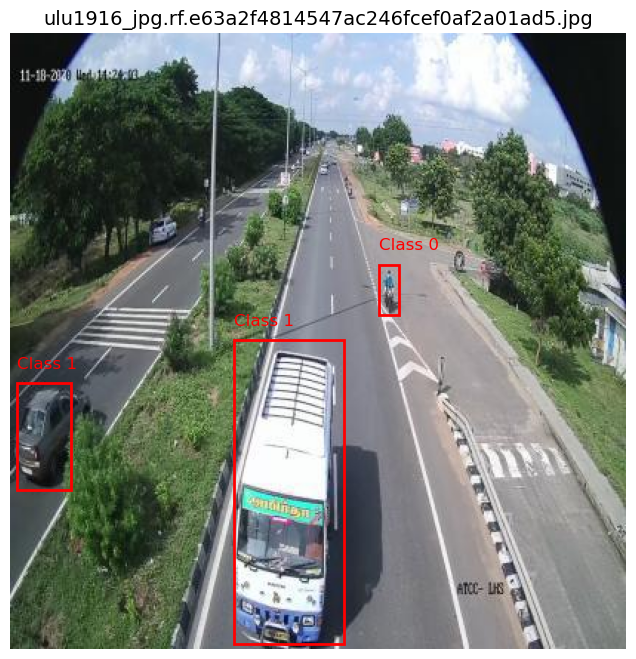

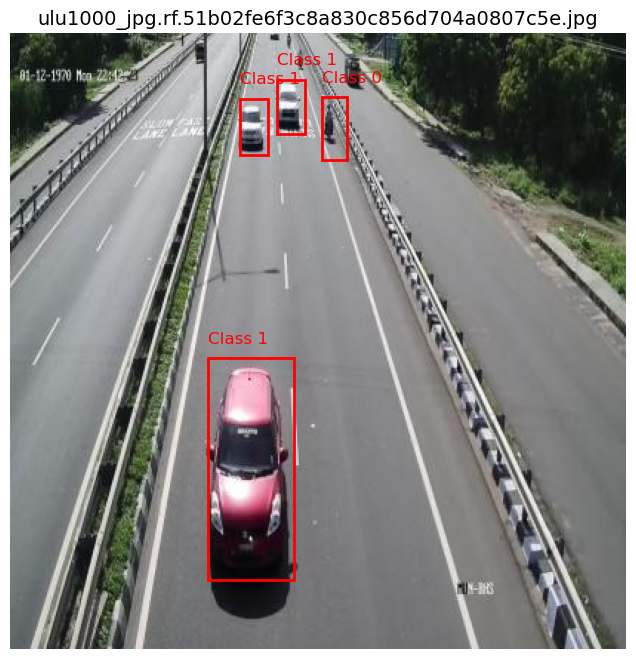

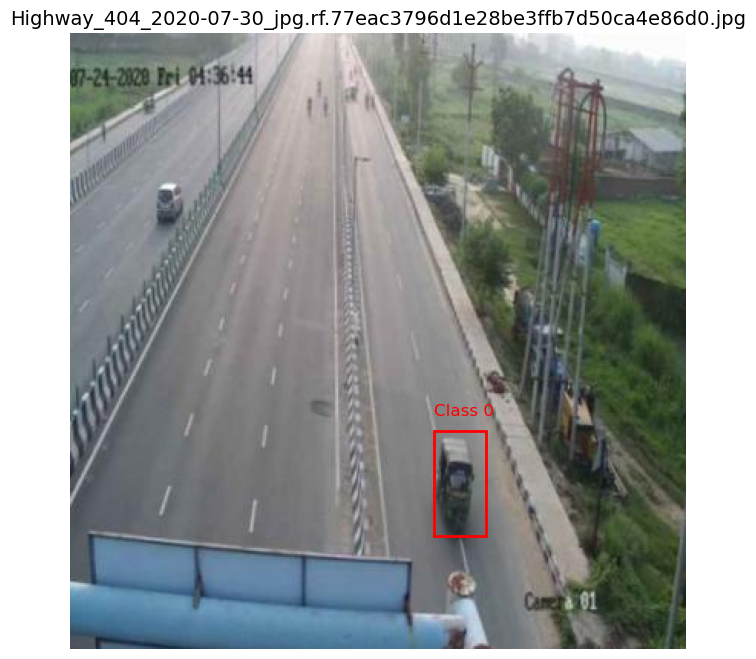

...

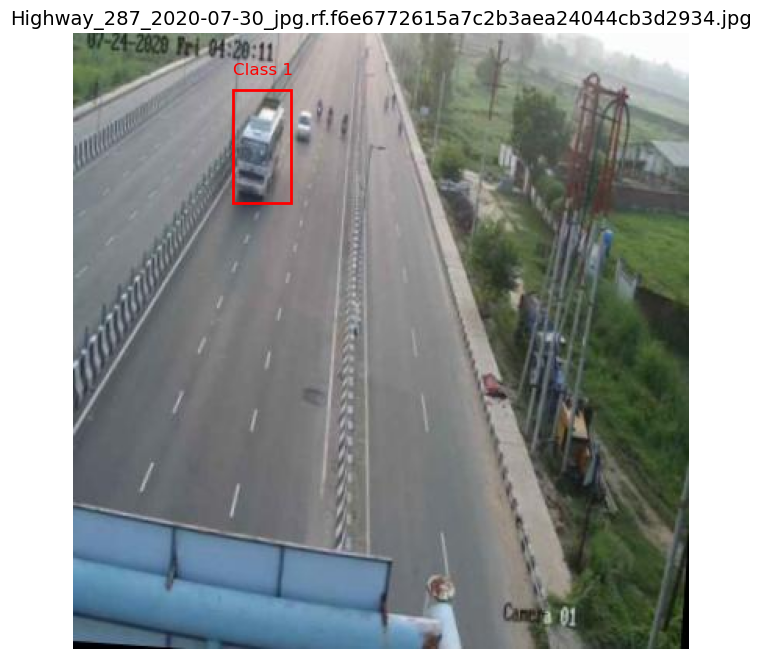

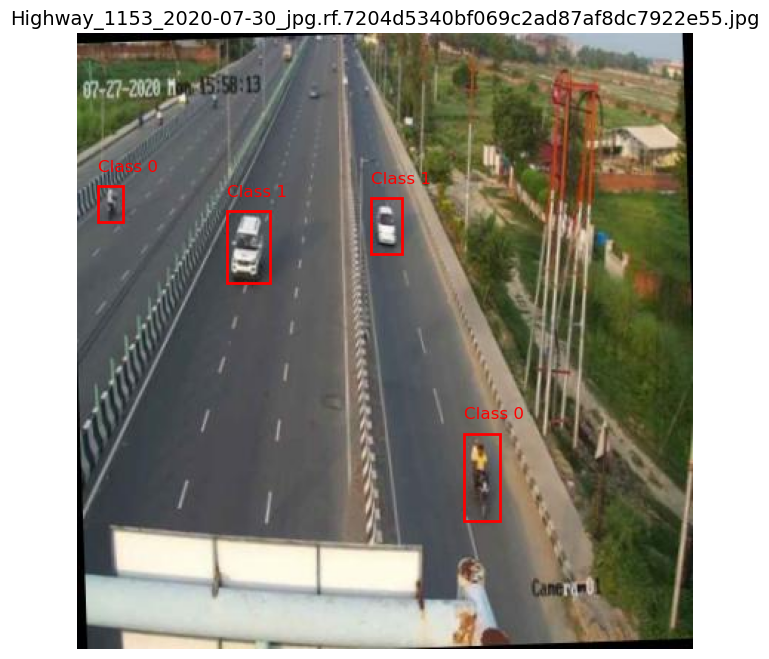

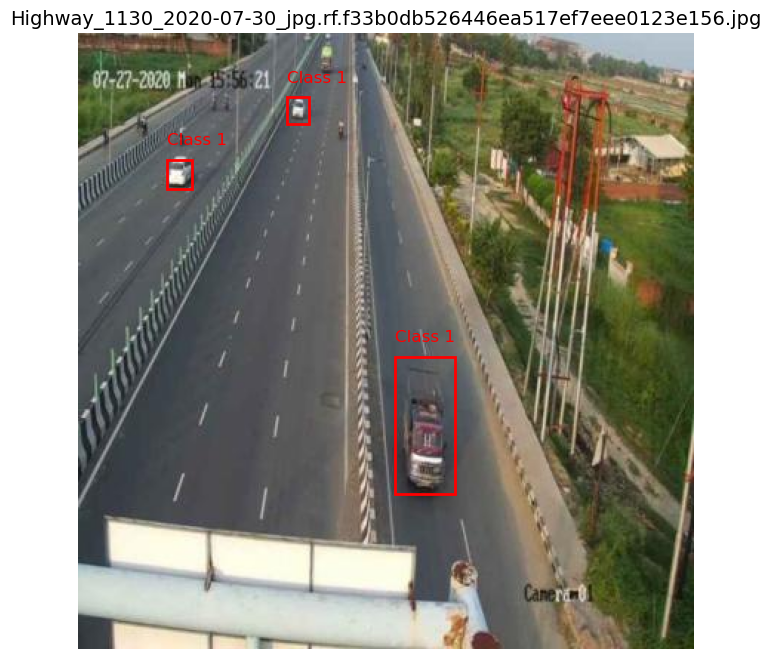

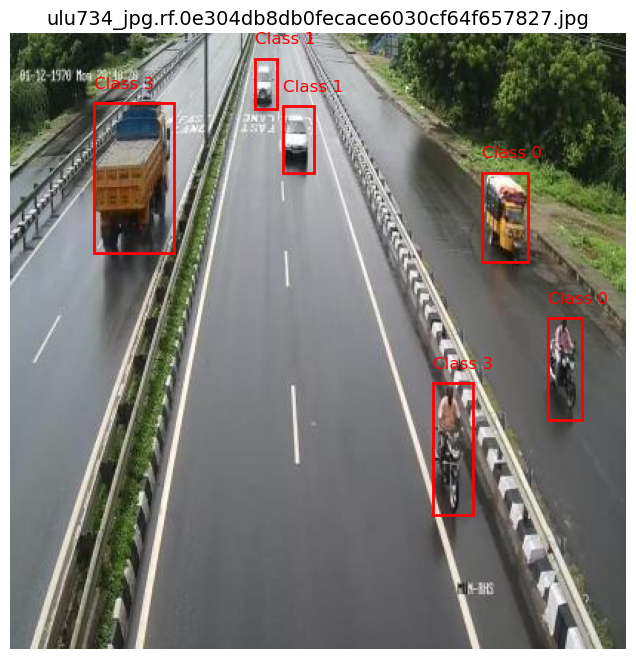

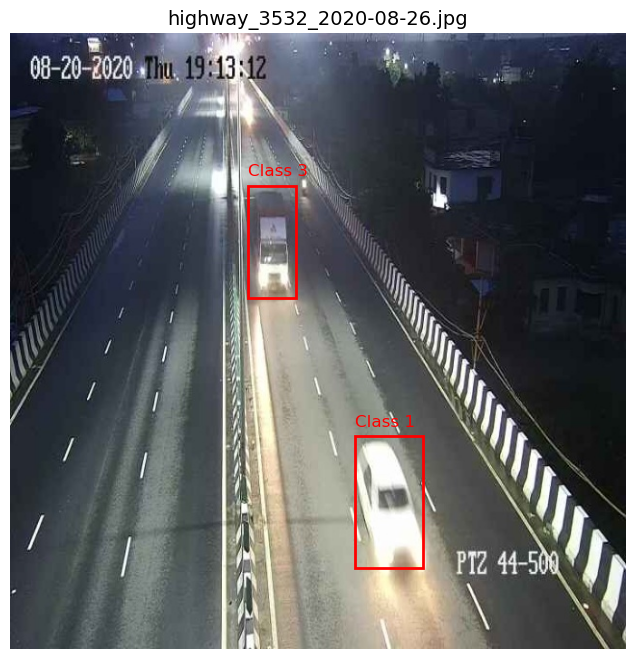

In [7]:
import os
import random
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from PIL import Image

# Define the path to the images and labels
image_folder = '/kaggle/working/traindata/images'
label_folder = '/kaggle/working/traindata/labels'

# Get a list of all images
image_files = [filename for filename in os.listdir(image_folder) if filename.endswith('.jpg')]

# Select random images
random_images = random.sample(image_files, 20)

# Function to display a single image with annotations
def display_image_with_annotations(image_path, label_path):
    # Open the image
    image = Image.open(image_path)
    img_width, img_height = image.size
    
    # Plot the image
    fig, ax = plt.subplots(figsize=(10, 8))
    ax.imshow(image)
    ax.set_title(os.path.basename(image_path), fontsize=14)
    
    # Read and plot the bounding boxes
    if os.path.exists(label_path):
        with open(label_path, 'r') as f:
            for line in f.readlines():
                # Parse each line: class_id, x_center, y_center, width, height
                class_id, x_center, y_center, width, height = map(float, line.split())
                
                # Convert normalized coordinates to image coordinates
                x_center *= img_width
                y_center *= img_height
                width *= img_width
                height *= img_height

                # Calculate the top-left corner of the bounding box
                x_min = x_center - width / 2
                y_min = y_center - height / 2

                # Create a rectangle patch
                rect = patches.Rectangle(
                    (x_min, y_min), width, height,
                    linewidth=2, edgecolor='r', facecolor='none'
                )

                # Add the patch to the plot
                ax.add_patch(rect)
                # Display class_id above the bounding box
                ax.text(x_min, y_min - 10, f'Class {int(class_id)}', color='red', fontsize=12)

    plt.axis('off')  # Turn off axis
    plt.show()

# Loop through the selected images and display each one with annotations
for image_file in random_images:
    image_path = os.path.join(image_folder, image_file)
    label_path = os.path.join(label_folder, image_file.replace('.jpg', '.txt'))
    display_image_with_annotations(image_path, label_path)


In [10]:
# Update YAML configuration
num_classes = len(CLASSES)
classes = CLASSES

dict_file = {'train': os.path.join('/kaggle/working/', 'traindata'),
             'val': os.path.join('/kaggle/working/', 'validdata'),
             'test': os.path.join('/kaggle/working/', 'testdata'),
             'nc': num_classes,
             'names': classes
            }

with open(os.path.join('/kaggle/working/', 'vehicledata.yaml'), 'w') as file:
    yaml.dump(dict_file, file)

In [11]:
class_idx = {str(i): classes[i] for i in range(num_classes)}

class_stat = {}
data_len = {}

for mode in ['traindata', 'validdata', 'testdata']:

    class_count = {classes[i]: 0 for i in range(num_classes)}

    path = os.path.join('/kaggle/working/', mode, 'labels')

    for file in os.listdir(path):
        with open(os.path.join(path, file)) as f:
            lines = f.readlines()

            for line in set(lines):
                cls = line[0]
                # Only count classes that are in class_idx
                if cls in class_idx:
                    class_count[class_idx[cls]] += 1

    data_len[mode] = len(os.listdir(path))
    class_stat[mode] = class_count

print(class_stat)
print(data_len)

{'traindata': {'Motorcycle': 6457, 'Car': 10151, 'Bus': 771, 'Truck': 3410}, 'validdata': {'Motorcycle': 412, 'Car': 589, 'Bus': 52, 'Truck': 229}, 'testdata': {'Motorcycle': 1235, 'Car': 1992, 'Bus': 146, 'Truck': 641}}
{'traindata': 6560, 'validdata': 412, 'testdata': 1228}


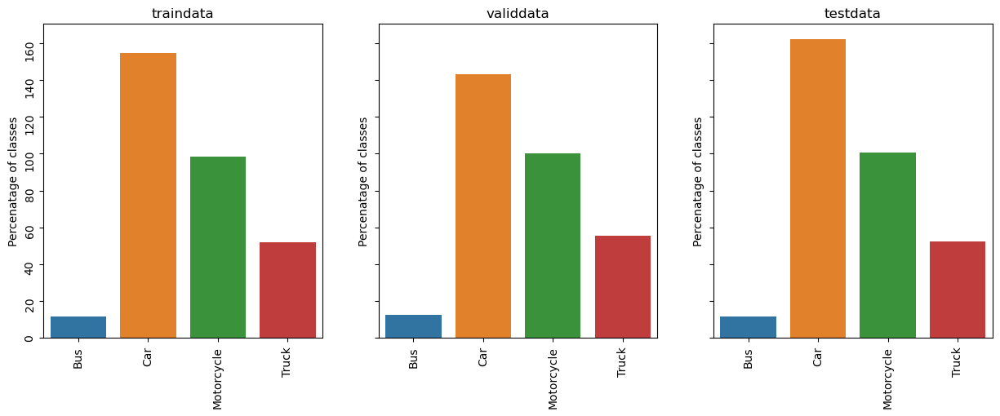

In [12]:
fig, ax = plt.subplots(1,3, figsize=(15, 5), sharey=True)

for i, mode in enumerate(['traindata', 'validdata','testdata']):
    sns.barplot(pd.DataFrame({mode:class_stat[mode]}).T/data_len[mode]*100, ax=ax[i])
    ax[i].set_title(mode)
    ax[i].tick_params(rotation=90)
    ax[i].set_ylabel('Percenatage of classes')
plt.show()

In [13]:
# Set up folder paths
train_folder = '/kaggle/working/traindata/images'
test_folder = '/kaggle/working/testdata/images'
valid_folder = '/kaggle/working/validdata/images'

# Define your target size
IMAGE_SIZE = 640

target_size = (IMAGE_SIZE, IMAGE_SIZE)  # Change this to your desired size

In [14]:
import os
import cv2
from PIL import Image
import albumentations as A
import numpy as np

# Define the augmentation pipeline
train_transform = A.Compose([
    A.HorizontalFlip(),
    A.ShiftScaleRotate(rotate_limit=10, value=0, border_mode=cv2.BORDER_CONSTANT),
    A.CLAHE(),
    A.GaussNoise(),
])

# Function to resize and augment images in a folder
def resize_and_augment_images_in_folder(folder_path):
    # Get list of image files
    image_files = [filename for filename in os.listdir(folder_path) if filename.endswith('.jpg')]

    # Resize and augment images in the folder
    for filename in image_files:
        image_path = os.path.join(folder_path, filename)
        
        # Open the image using PIL
        image = Image.open(image_path)
        
        # Resize the image to the target size
        resized_image = image.resize(target_size)
        
        # Convert the resized image to a NumPy array
        image_np = np.array(resized_image)

        # Apply augmentations
        augmented = train_transform(image=image_np)
        augmented_image = augmented['image']

        # Convert back to PIL Image
        augmented_pil_image = Image.fromarray(augmented_image)

        # Save the augmented image (you can also save in a different folder if needed)
        augmented_pil_image.save(image_path)

In [15]:
import os
from PIL import Image

# Function to resize images in a folder
def resize_images_in_folder(folder_path):
    # Get list of image files
    image_files = [filename for filename in os.listdir(folder_path) if filename.endswith('.jpg')]

    # Resize images in the folder
    for filename in image_files:
        image_path = os.path.join(folder_path, filename)
        
        # Open the image using PIL
        image = Image.open(image_path)
        
        # Resize the image to the target size
        resized_image = image.resize(target_size)
        
        # Save the resized image
        resized_image.save(image_path)

In [16]:
# Resize images in the train folder
resize_and_augment_images_in_folder(train_folder)

# Resize images in the test folder
resize_images_in_folder(test_folder)

# Resize images in the valid folder
resize_images_in_folder(valid_folder)

In [17]:
for mode in ['traindata', 'validdata', 'testdata']:
    print(f'\nImage sizes in {mode} set:\n')
    img_size = 0
    for file in glob.glob(os.path.join('/kaggle/working/', mode, 'images', '*')):
        image = Image.open(file)
        if image.size != img_size:
            print(f'\t{image.size}')
            img_size = image.size


Image sizes in traindata set:

	(640, 640)

Image sizes in validdata set:

	(640, 640)

Image sizes in testdata set:

	(640, 640)


In [18]:
for mode in ['traindata', 'validdata', 'testdata']:

    files =  glob.glob(os.path.join('/kaggle/working/', mode, 'images', '*'))

    print(f'{mode} set size: {len(files)}\n')

traindata set size: 6574

validdata set size: 412

testdata set size: 1232



In [19]:
model = YOLO("yolov8m.pt")

100%|██████████| 49.7M/49.7M [00:00<00:00, 238MB/s]


In [20]:
model.train(data=os.path.join('/kaggle/working/','vehicledata.yaml'),
            task='detect',
            imgsz=IMAGE_SIZE,
            epochs=100,
            batch=8,
            mode='train',
            name='yolov8m_v1_train',
            device=[0,1])

Ultralytics 8.3.40 🚀 Python-3.10.10 torch-2.0.0 CUDA:0 (Tesla T4, 15095MiB)
                                                 CUDA:1 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolov8m.pt, data=/kaggle/working/vehicledata.yaml, epochs=100, time=None, patience=100, batch=8, imgsz=640, save=True, save_period=-1, cache=False, device=[0, 1], workers=8, project=None, name=yolov8m_v1_train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save

100%|██████████| 755k/755k [00:00<00:00, 16.6MB/s]
2024-12-03 05:53:31,216	INFO util.py:124 -- Outdated packages:
  ipywidgets==7.7.1 found, needs ipywidgets>=8
Run `pip install -U ipywidgets`, then restart the notebook server for rich notebook output.
2024-12-03 05:53:31,645	INFO util.py:124 -- Outdated packages:
  ipywidgets==7.7.1 found, needs ipywidgets>=8
Run `pip install -U ipywidgets`, then restart the notebook server for rich notebook output.
/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/__init__.py:98: UserWarning: unable to load libtensorflow_io_plugins.so: unable to open file: libtensorflow_io_plugins.so, from paths: ['/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/libtensorflow_io_plugins.so']
caused by: ['/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/libtensorflow_io_plugins.so: undefined symbol: _ZN3tsl6StatusC1EN10tensorflow5error4CodeESt17basic_string_viewIcSt11char_traitsIcEENS_14SourceLocationE']
  warnings.warn(

Overriding model.yaml nc=80 with nc=4

                   from  n    params  module                                       arguments                     
  0                  -1  1      1392  ultralytics.nn.modules.conv.Conv             [3, 48, 3, 2]                 
  1                  -1  1     41664  ultralytics.nn.modules.conv.Conv             [48, 96, 3, 2]                
  2                  -1  2    111360  ultralytics.nn.modules.block.C2f             [96, 96, 2, True]             
  3                  -1  1    166272  ultralytics.nn.modules.conv.Conv             [96, 192, 3, 2]               
  4                  -1  4    813312  ultralytics.nn.modules.block.C2f             [192, 192, 4, True]           
  5                  -1  1    664320  ultralytics.nn.modules.conv.Conv             [192, 384, 3, 2]              
  6                  -1  4   3248640  ultralytics.nn.modules.block.C2f             [384, 384, 4, True]           
  7                  -1  1   1991808  ultralytics

/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/__init__.py:98: UserWarning: unable to load libtensorflow_io_plugins.so: unable to open file: libtensorflow_io_plugins.so, from paths: ['/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/libtensorflow_io_plugins.so']
caused by: ['/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/libtensorflow_io_plugins.so: undefined symbol: _ZN3tsl6StatusC1EN10tensorflow5error4CodeESt17basic_string_viewIcSt11char_traitsIcEENS_14SourceLocationE']
  warnings.warn(f"unable to load libtensorflow_io_plugins.so: {e}")
/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/__init__.py:104: UserWarning: file system plugins are not loaded: unable to open file: libtensorflow_io.so, from paths: ['/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/libtensorflow_io.so']
caused by: ['/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/libtensorflow_io.so: undefined symbol: _ZTVN10tenso

TensorBoard: Start with 'tensorboard --logdir runs/detect/yolov8m_v1_train', view at http://localhost:6006/
Overriding model.yaml nc=80 with nc=4
Transferred 469/475 items from pretrained weights
Freezing layer 'model.22.dfl.conv.weight'
AMP: running Automatic Mixed Precision (AMP) checks...


100%|██████████| 5.35M/5.35M [00:00<00:00, 70.7MB/s]


AMP: checks passed ✅


train: Scanning /kaggle/working/traindata/labels... 6560 images, 14 backgrounds, 0 corrupt: 100%|██████████| 6574/6574 [00:04<00:00, 1317.86it/s]


train: WARNING ⚠️ /kaggle/working/traindata/images/highway_2651_2020-08-26.jpg: 1 duplicate labels removed
train: WARNING ⚠️ /kaggle/working/traindata/images/highway_2682_2020-08-26.jpg: 1 duplicate labels removed
train: WARNING ⚠️ /kaggle/working/traindata/images/highway_2695_2020-08-26.jpg: 1 duplicate labels removed
train: WARNING ⚠️ /kaggle/working/traindata/images/highway_2696_2020-08-26.jpg: 1 duplicate labels removed
train: WARNING ⚠️ /kaggle/working/traindata/images/highway_2744_2020-08-26.jpg: 1 duplicate labels removed
train: WARNING ⚠️ /kaggle/working/traindata/images/highway_2751_2020-08-26.jpg: 1 duplicate labels removed
train: WARNING ⚠️ /kaggle/working/traindata/images/highway_3001_2020-08-26.jpg: 1 duplicate labels removed
train: WARNING ⚠️ /kaggle/working/traindata/images/highway_3297_2020-08-26.jpg: 1 duplicate labels removed
train: WARNING ⚠️ /kaggle/working/traindata/images/highway_3456_2020-08-26.jpg: 1 duplicate labels removed
train: WARNING ⚠️ /kaggle/working/tra

val: Scanning /kaggle/working/validdata/labels... 412 images, 0 backgrounds, 0 corrupt: 100%|██████████| 412/412 [00:00<00:00, 1567.51it/s]


val: New cache created: /kaggle/working/validdata/labels.cache
Plotting labels to runs/detect/yolov8m_v1_train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: SGD(lr=0.01, momentum=0.9) with parameter groups 77 weight(decay=0.0), 84 weight(decay=0.0005), 83 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 4 dataloader workers
Logging results to runs/detect/yolov8m_v1_train
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100      2.47G      2.525      3.575      1.985         13        640: 100%|██████████| 822/822 [03:43<00:00,  3.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:08<00:00,  5.82it/s]


                   all        412       1282      0.492      0.606      0.547      0.304

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100      2.29G      2.316       3.08      1.805         24        640: 100%|██████████| 822/822 [03:33<00:00,  3.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.10it/s]


                   all        412       1282      0.535      0.573      0.548      0.306

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100      2.38G      2.347      3.117      1.808         13        640: 100%|██████████| 822/822 [03:32<00:00,  3.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.03it/s]


                   all        412       1282      0.539      0.449      0.478      0.248

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100      2.37G      2.392      3.198      1.839         11        640: 100%|██████████| 822/822 [03:30<00:00,  3.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.00it/s]


                   all        412       1282      0.733      0.375      0.448      0.235

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100      2.36G      2.299      3.054      1.785         29        640: 100%|██████████| 822/822 [03:30<00:00,  3.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  6.97it/s]


                   all        412       1282      0.547      0.631       0.59       0.33

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100       2.3G      2.287      3.029      1.785         25        640: 100%|██████████| 822/822 [03:30<00:00,  3.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.10it/s]


                   all        412       1282      0.695      0.567      0.567      0.313

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100      2.37G      2.288      3.048      1.778         14        640: 100%|██████████| 822/822 [03:31<00:00,  3.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.07it/s]


                   all        412       1282      0.792      0.541      0.612      0.342

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100      2.36G      2.202      2.901      1.737          7        640: 100%|██████████| 822/822 [03:30<00:00,  3.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.06it/s]


                   all        412       1282      0.627       0.59      0.647      0.363

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100      2.36G      2.201      2.909      1.742          5        640: 100%|██████████| 822/822 [03:30<00:00,  3.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.09it/s]


                   all        412       1282      0.587      0.515       0.58      0.344

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100      2.32G      2.173      2.884      1.735          8        640: 100%|██████████| 822/822 [03:29<00:00,  3.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.10it/s]


                   all        412       1282      0.556      0.575      0.622       0.35

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100      2.38G      2.157      2.881      1.733         15        640: 100%|██████████| 822/822 [03:28<00:00,  3.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  6.99it/s]


                   all        412       1282      0.735      0.529      0.567       0.33

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100      2.37G      2.132      2.818      1.713         11        640: 100%|██████████| 822/822 [03:28<00:00,  3.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.09it/s]


                   all        412       1282      0.774      0.542      0.613      0.359

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100      2.36G      2.116      2.786      1.701         11        640: 100%|██████████| 822/822 [03:29<00:00,  3.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.07it/s]


                   all        412       1282      0.571      0.619      0.648      0.378

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100       2.3G      2.095      2.768      1.694         10        640: 100%|██████████| 822/822 [03:29<00:00,  3.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.13it/s]


                   all        412       1282      0.612      0.598      0.641      0.381

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100      2.36G       2.08      2.744      1.684         19        640: 100%|██████████| 822/822 [03:30<00:00,  3.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.07it/s]


                   all        412       1282      0.585      0.648      0.681      0.403

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100      2.37G      2.033      2.682      1.664         15        640: 100%|██████████| 822/822 [03:29<00:00,  3.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.01it/s]


                   all        412       1282      0.572        0.6      0.646      0.385

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100      2.36G      2.072      2.727      1.681         11        640: 100%|██████████| 822/822 [03:29<00:00,  3.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.05it/s]


                   all        412       1282      0.575      0.583      0.665      0.404

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100      2.32G      2.051      2.723      1.675         14        640: 100%|██████████| 822/822 [03:28<00:00,  3.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.10it/s]


                   all        412       1282      0.642      0.644      0.686      0.413

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100      2.37G      2.026      2.695      1.657          6        640: 100%|██████████| 822/822 [03:28<00:00,  3.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.17it/s]


                   all        412       1282      0.653      0.691      0.684      0.417

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100      2.37G      2.011      2.633      1.638         20        640: 100%|██████████| 822/822 [03:26<00:00,  3.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.26it/s]


                   all        412       1282      0.573       0.62       0.67      0.395

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100      2.38G      2.015      2.675      1.642         21        640: 100%|██████████| 822/822 [03:27<00:00,  3.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.06it/s]


                   all        412       1282      0.699      0.612      0.674      0.406

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100      2.31G      1.982      2.598      1.629          7        640: 100%|██████████| 822/822 [03:28<00:00,  3.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.13it/s]


                   all        412       1282      0.682       0.66      0.692      0.423

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100      2.35G      2.015      2.649      1.647          5        640: 100%|██████████| 822/822 [03:28<00:00,  3.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.19it/s]


                   all        412       1282      0.647      0.672      0.674      0.408

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100      2.37G      1.995      2.617      1.636          6        640: 100%|██████████| 822/822 [03:28<00:00,  3.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.06it/s]


                   all        412       1282      0.652      0.708      0.698      0.421

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100      2.38G      1.971        2.6      1.623          7        640: 100%|██████████| 822/822 [03:27<00:00,  3.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.09it/s]


                   all        412       1282      0.642      0.636      0.676      0.418

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100       2.3G      1.971      2.589       1.62          6        640: 100%|██████████| 822/822 [03:27<00:00,  3.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.19it/s]


                   all        412       1282      0.666      0.699      0.713      0.445

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100      2.38G      1.961      2.586      1.614         11        640: 100%|██████████| 822/822 [03:28<00:00,  3.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.14it/s]


                   all        412       1282      0.674      0.612      0.672      0.412

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100      2.38G      1.939      2.552      1.605         13        640: 100%|██████████| 822/822 [03:28<00:00,  3.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.22it/s]


                   all        412       1282      0.671      0.684      0.687      0.427

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100      2.37G      1.952      2.532      1.604         19        640: 100%|██████████| 822/822 [03:27<00:00,  3.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.16it/s]


                   all        412       1282      0.654       0.69      0.682      0.422

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100       2.3G      1.932      2.506      1.596         16        640: 100%|██████████| 822/822 [03:29<00:00,  3.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  6.99it/s]


                   all        412       1282      0.595      0.675      0.687      0.425

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100      2.37G      1.919      2.506      1.589         16        640: 100%|██████████| 822/822 [03:29<00:00,  3.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.17it/s]


                   all        412       1282      0.671      0.712      0.701      0.432

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100      2.36G      1.932      2.515      1.588         13        640: 100%|██████████| 822/822 [03:28<00:00,  3.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.16it/s]


                   all        412       1282      0.675      0.682      0.704      0.432

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100      2.36G      1.905      2.491      1.574         11        640: 100%|██████████| 822/822 [03:28<00:00,  3.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.21it/s]


                   all        412       1282      0.676      0.692      0.702      0.435

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100       2.3G      1.907      2.474      1.574         17        640: 100%|██████████| 822/822 [03:28<00:00,  3.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.11it/s]


                   all        412       1282      0.634      0.654      0.677      0.411

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100      2.36G      1.889      2.474      1.575         18        640: 100%|██████████| 822/822 [03:27<00:00,  3.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.12it/s]


                   all        412       1282      0.661      0.726      0.721      0.446

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100      2.37G      1.876      2.414      1.564         17        640: 100%|██████████| 822/822 [03:28<00:00,  3.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.20it/s]


                   all        412       1282      0.652      0.661      0.712       0.44

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100      2.36G      1.887      2.424      1.564          7        640: 100%|██████████| 822/822 [03:29<00:00,  3.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.12it/s]


                   all        412       1282      0.712      0.688      0.724      0.454

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100       2.3G      1.841      2.375      1.529         15        640: 100%|██████████| 822/822 [03:29<00:00,  3.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.16it/s]


                   all        412       1282      0.651      0.691      0.706       0.44

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100      2.36G      1.847      2.384      1.537          8        640: 100%|██████████| 822/822 [03:29<00:00,  3.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.13it/s]


                   all        412       1282      0.712      0.678      0.725      0.461

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100      2.38G      1.862      2.394      1.546         11        640: 100%|██████████| 822/822 [03:28<00:00,  3.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.08it/s]


                   all        412       1282       0.67       0.72      0.713      0.445

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100      2.37G      1.877      2.416      1.539         18        640: 100%|██████████| 822/822 [03:27<00:00,  3.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.23it/s]


                   all        412       1282      0.676       0.67      0.728      0.455

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100       2.3G      1.844      2.378      1.534         11        640: 100%|██████████| 822/822 [03:27<00:00,  3.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.22it/s]


                   all        412       1282      0.684      0.707      0.715      0.442

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100      2.36G      1.835      2.344      1.528         14        640: 100%|██████████| 822/822 [03:27<00:00,  3.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.22it/s]


                   all        412       1282      0.715        0.7      0.736      0.464

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100      2.37G      1.835      2.365      1.535          8        640: 100%|██████████| 822/822 [03:27<00:00,  3.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.05it/s]


                   all        412       1282      0.709      0.722      0.738      0.464

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100      2.37G      1.808      2.325      1.517         13        640: 100%|██████████| 822/822 [03:27<00:00,  3.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.22it/s]


                   all        412       1282      0.682      0.705       0.74      0.469

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100       2.3G       1.83      2.344      1.526         12        640: 100%|██████████| 822/822 [03:28<00:00,  3.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.24it/s]


                   all        412       1282      0.718      0.736      0.748      0.476

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100      2.36G      1.811      2.346      1.524          9        640: 100%|██████████| 822/822 [03:28<00:00,  3.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.22it/s]


                   all        412       1282      0.716      0.703      0.746      0.474

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100      2.38G      1.824      2.352      1.526         11        640: 100%|██████████| 822/822 [03:26<00:00,  3.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.08it/s]


                   all        412       1282      0.726      0.729      0.755      0.482

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100      2.36G      1.796      2.325      1.502         17        640: 100%|██████████| 822/822 [03:27<00:00,  3.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.17it/s]


                   all        412       1282      0.688      0.714      0.729      0.464

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100       2.3G      1.805      2.318      1.497          9        640: 100%|██████████| 822/822 [03:30<00:00,  3.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.04it/s]


                   all        412       1282      0.677      0.715      0.718      0.456

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100      2.37G      1.764      2.255      1.483         12        640: 100%|██████████| 822/822 [03:32<00:00,  3.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.16it/s]


                   all        412       1282      0.715      0.719      0.754      0.485

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100      2.37G      1.803       2.31      1.516         11        640: 100%|██████████| 822/822 [03:29<00:00,  3.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.24it/s]


                   all        412       1282      0.736      0.725      0.749      0.481

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100      2.37G      1.762      2.245      1.471         10        640: 100%|██████████| 822/822 [03:29<00:00,  3.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.23it/s]


                   all        412       1282      0.745      0.724      0.752       0.48

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100      2.31G      1.754       2.24      1.477         11        640: 100%|██████████| 822/822 [03:28<00:00,  3.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.03it/s]


                   all        412       1282      0.725      0.721      0.748      0.481

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100      2.36G      1.761      2.253      1.486          9        640: 100%|██████████| 822/822 [03:29<00:00,  3.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.22it/s]


                   all        412       1282      0.704      0.699      0.727      0.475

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100      2.36G      1.745      2.224      1.479         28        640: 100%|██████████| 822/822 [03:32<00:00,  3.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.13it/s]


                   all        412       1282      0.718      0.726      0.748      0.479

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100      2.36G      1.749      2.235      1.472         13        640: 100%|██████████| 822/822 [03:31<00:00,  3.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.15it/s]


                   all        412       1282        0.7      0.689      0.713      0.464

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100       2.3G      1.756      2.232      1.478         21        640: 100%|██████████| 822/822 [03:33<00:00,  3.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.08it/s]


                   all        412       1282       0.72       0.69      0.733      0.475

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100      2.37G      1.731      2.217      1.472         15        640: 100%|██████████| 822/822 [03:32<00:00,  3.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.05it/s]


                   all        412       1282      0.701      0.703      0.731      0.473

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100      2.36G       1.72      2.194      1.455          4        640: 100%|██████████| 822/822 [03:32<00:00,  3.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.16it/s]


                   all        412       1282      0.677      0.691      0.703      0.454

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100      2.37G      1.715      2.202      1.443         19        640: 100%|██████████| 822/822 [03:33<00:00,  3.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.00it/s]


                   all        412       1282      0.718       0.69      0.723      0.461

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100      2.31G       1.73      2.212      1.461         11        640: 100%|██████████| 822/822 [03:32<00:00,  3.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  6.92it/s]


                   all        412       1282      0.717      0.681       0.72      0.463

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100      2.36G      1.729      2.207       1.46          5        640: 100%|██████████| 822/822 [03:33<00:00,  3.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  6.99it/s]


                   all        412       1282      0.691      0.695      0.714      0.461

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100      2.36G      1.695      2.156       1.45         22        640: 100%|██████████| 822/822 [03:33<00:00,  3.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.15it/s]


                   all        412       1282      0.685      0.703      0.724      0.472

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100      2.36G      1.705      2.166      1.441         18        640: 100%|██████████| 822/822 [03:34<00:00,  3.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.08it/s]


                   all        412       1282      0.655      0.684       0.71      0.459

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100       2.3G      1.707       2.17      1.429         14        640: 100%|██████████| 822/822 [03:34<00:00,  3.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  6.96it/s]


                   all        412       1282      0.657      0.664      0.697       0.45

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100      2.36G      1.669      2.118      1.425          7        640: 100%|██████████| 822/822 [03:33<00:00,  3.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.00it/s]


                   all        412       1282       0.66      0.677      0.703      0.454

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/100      2.37G      1.686      2.113      1.429          9        640: 100%|██████████| 822/822 [03:33<00:00,  3.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.12it/s]


                   all        412       1282      0.669      0.694      0.714      0.461

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100      2.36G      1.689      2.136      1.433         20        640: 100%|██████████| 822/822 [03:33<00:00,  3.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.10it/s]


                   all        412       1282      0.677      0.684      0.726      0.473

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100       2.3G      1.672      2.105      1.421          7        640: 100%|██████████| 822/822 [03:33<00:00,  3.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.14it/s]


                   all        412       1282      0.668      0.699      0.717      0.467

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100      2.36G      1.664      2.106      1.423         18        640: 100%|██████████| 822/822 [03:33<00:00,  3.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.10it/s]


                   all        412       1282      0.652      0.685      0.716      0.464

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100      2.36G      1.665      2.086      1.411         11        640: 100%|██████████| 822/822 [03:33<00:00,  3.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.08it/s]


                   all        412       1282      0.664      0.684       0.72      0.466

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100      2.38G      1.654       2.07      1.413         22        640: 100%|██████████| 822/822 [03:33<00:00,  3.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.07it/s]


                   all        412       1282       0.68      0.684      0.711      0.463

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100       2.3G      1.658      2.092       1.42          6        640: 100%|██████████| 822/822 [03:33<00:00,  3.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.04it/s]


                   all        412       1282      0.703       0.66      0.705      0.454

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100      2.37G       1.66        2.1      1.417         13        640: 100%|██████████| 822/822 [03:32<00:00,  3.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.07it/s]


                   all        412       1282      0.662      0.652      0.701      0.457

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/100      2.36G      1.648      2.094      1.418         19        640: 100%|██████████| 822/822 [03:30<00:00,  3.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.17it/s]


                   all        412       1282      0.647      0.675        0.7      0.457

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100      2.37G      1.636       2.05      1.404          5        640: 100%|██████████| 822/822 [03:31<00:00,  3.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.16it/s]


                   all        412       1282       0.66      0.686      0.694      0.452

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/100       2.3G      1.622      2.046      1.395         17        640: 100%|██████████| 822/822 [03:31<00:00,  3.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.14it/s]


                   all        412       1282       0.66      0.684      0.698      0.456

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/100      2.37G       1.62      2.055      1.399         12        640: 100%|██████████| 822/822 [03:30<00:00,  3.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.18it/s]


                   all        412       1282      0.629      0.705      0.703      0.461

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/100      2.34G       1.59      1.976      1.375          7        640: 100%|██████████| 822/822 [03:29<00:00,  3.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.24it/s]


                   all        412       1282       0.65      0.688      0.717      0.468

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/100      2.36G      1.625      2.053      1.393         11        640: 100%|██████████| 822/822 [03:29<00:00,  3.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.02it/s]


                   all        412       1282      0.653      0.686      0.702      0.458

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/100       2.3G        1.6      2.016      1.391         20        640: 100%|██████████| 822/822 [03:28<00:00,  3.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.27it/s]


                   all        412       1282      0.672      0.675      0.701      0.457

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/100      2.36G      1.599      1.998      1.387          9        640: 100%|██████████| 822/822 [03:28<00:00,  3.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.24it/s]


                   all        412       1282      0.642      0.677      0.686      0.446

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/100      2.36G      1.587      1.977      1.374         15        640: 100%|██████████| 822/822 [03:28<00:00,  3.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.22it/s]


                   all        412       1282      0.656      0.656      0.679      0.444

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/100      2.36G      1.616      2.017      1.389         12        640: 100%|██████████| 822/822 [03:29<00:00,  3.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.20it/s]


                   all        412       1282      0.637      0.665      0.668      0.436

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/100       2.3G      1.578      1.972      1.371          7        640: 100%|██████████| 822/822 [03:28<00:00,  3.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.08it/s]


                   all        412       1282      0.631      0.665      0.664      0.431

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/100      2.37G      1.586      1.983      1.375         13        640: 100%|██████████| 822/822 [03:28<00:00,  3.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.19it/s]


                   all        412       1282      0.611      0.685      0.672      0.435

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/100      2.37G      1.563      1.935      1.357         30        640: 100%|██████████| 822/822 [03:29<00:00,  3.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.24it/s]


                   all        412       1282      0.616      0.687      0.666      0.431

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/100      2.37G      1.554      1.919      1.353          3        640: 100%|██████████| 822/822 [03:29<00:00,  3.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.10it/s]


                   all        412       1282      0.603      0.678      0.661      0.429

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/100       2.3G      1.568       1.94      1.368         16        640: 100%|██████████| 822/822 [03:28<00:00,  3.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.15it/s]


                   all        412       1282      0.611      0.662      0.658       0.43
Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/100      2.36G      1.516      1.833      1.366         14        640: 100%|██████████| 822/822 [03:27<00:00,  3.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.19it/s]


                   all        412       1282      0.612      0.679      0.664      0.433

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/100      2.36G       1.49      1.779      1.354         15        640: 100%|██████████| 822/822 [03:26<00:00,  3.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.25it/s]


                   all        412       1282      0.593      0.681      0.663       0.43

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/100      2.36G      1.488      1.788      1.353          9        640: 100%|██████████| 822/822 [03:26<00:00,  3.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.22it/s]


                   all        412       1282      0.592      0.676       0.66       0.43

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/100       2.3G      1.477      1.781       1.34          9        640: 100%|██████████| 822/822 [03:26<00:00,  3.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.09it/s]


                   all        412       1282       0.58      0.677      0.656      0.427

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/100      2.37G       1.48      1.774      1.342          7        640: 100%|██████████| 822/822 [03:26<00:00,  3.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.26it/s]


                   all        412       1282      0.574      0.669      0.635      0.413

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/100      2.36G      1.469      1.746      1.334          6        640: 100%|██████████| 822/822 [03:26<00:00,  3.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.27it/s]


                   all        412       1282       0.58      0.652      0.635      0.413

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/100      2.36G      1.457      1.735      1.329          8        640: 100%|██████████| 822/822 [03:26<00:00,  3.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.20it/s]


                   all        412       1282      0.584      0.645      0.631       0.41

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/100      2.31G      1.465      1.761      1.335         10        640: 100%|██████████| 822/822 [03:26<00:00,  3.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.15it/s]


                   all        412       1282      0.577      0.645       0.62      0.406

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/100      2.35G      1.452      1.719      1.322          6        640: 100%|██████████| 822/822 [03:26<00:00,  3.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.24it/s]


                   all        412       1282       0.58      0.628      0.617      0.403

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/100      2.37G      1.455      1.743      1.329          5        640: 100%|██████████| 822/822 [03:26<00:00,  3.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:07<00:00,  7.27it/s]


                   all        412       1282      0.578      0.625      0.614        0.4

100 epochs completed in 6.059 hours.
Optimizer stripped from runs/detect/yolov8m_v1_train/weights/last.pt, 52.0MB
Optimizer stripped from runs/detect/yolov8m_v1_train/weights/best.pt, 52.0MB

Validating runs/detect/yolov8m_v1_train/weights/best.pt...
Ultralytics 8.3.40 🚀 Python-3.10.10 torch-2.0.0 CUDA:0 (Tesla T4, 15095MiB)
                                                 CUDA:1 (Tesla T4, 15095MiB)
Model summary (fused): 218 layers, 25,842,076 parameters, 0 gradients, 78.7 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 52/52 [00:06<00:00,  7.51it/s]


                   all        412       1282      0.716      0.719      0.753      0.485
            Motorcycle        227        412      0.792      0.733      0.797      0.409
                   Car        307        589      0.763      0.884      0.891      0.593
                   Bus         52         52      0.658      0.442      0.514      0.355
                 Truck        196        229      0.653      0.817      0.811      0.584
Speed: 0.4ms preprocess, 11.7ms inference, 0.0ms loss, 1.0ms postprocess per image
Results saved to runs/detect/yolov8m_v1_train


In [21]:
model = YOLO('/kaggle/working/runs/detect/yolov8m_v1_train/weights/best.pt')

In [22]:
results = model.predict(source=os.path.join('/kaggle/working/', 'testdata', 'images'), save=True)



WARNING ⚠️ inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

image 1/1232 /kaggle/working/testdata/images/Highway_1003_2020-07-30_jpg.rf.b14eddb12ef456c4b5b0721a6e995f13.jpg: 640x640 (no detections), 48.0ms
image 2/1232 /kaggle/working/testdata/images/Highway_1008_2020-07-30_jpg.rf.20cbb582c956967507788adbf406ff04.jpg: 640x640 3 Motorcycles, 1 Car, 46.3ms
image 3/1232 /kaggle/working/testdata/images/Highway_1016_2020-07-30_jpg.rf.c06768064557dae82aba20e9dcdf11bd.jpg: 640x640 1 Motorcycle, 1 Truck, 46.6ms
image 4

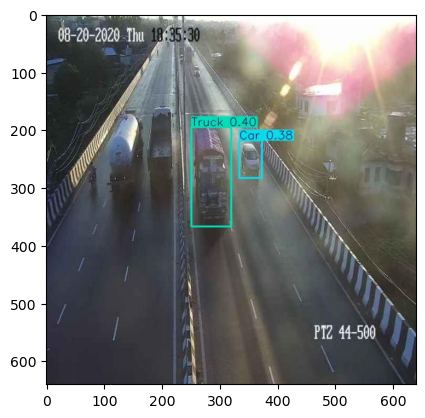

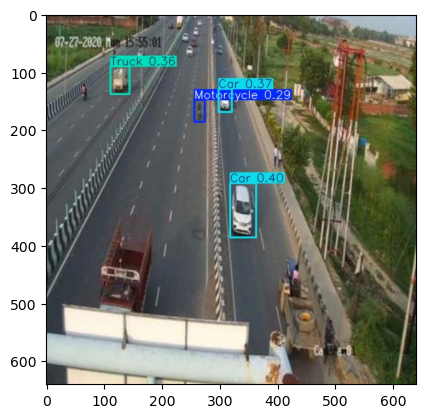

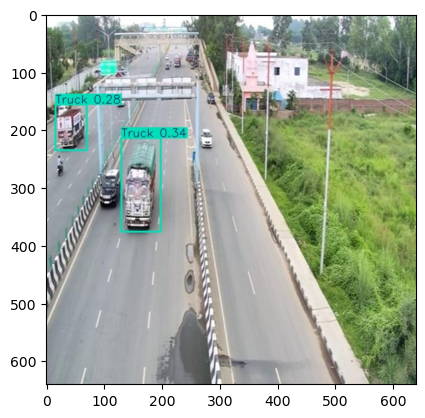

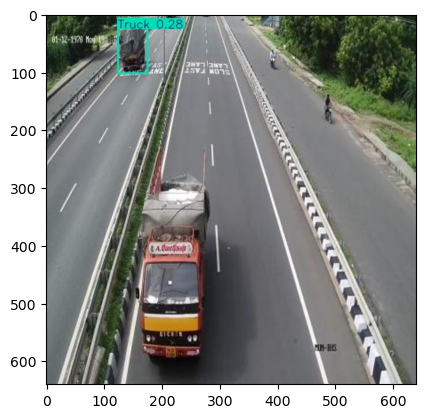

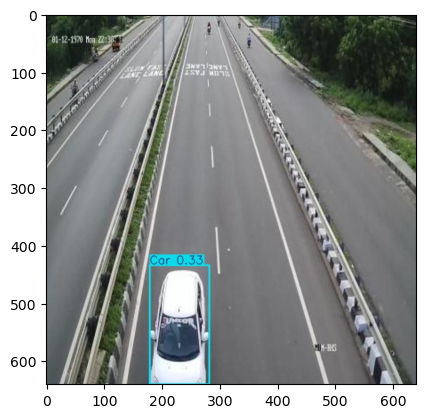

...

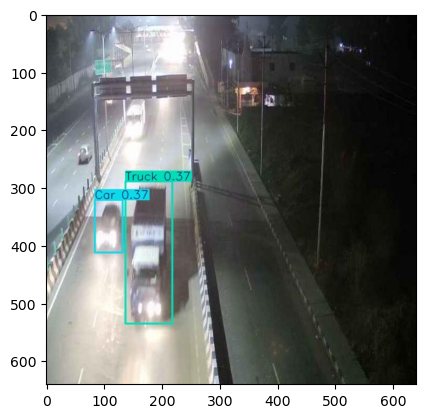

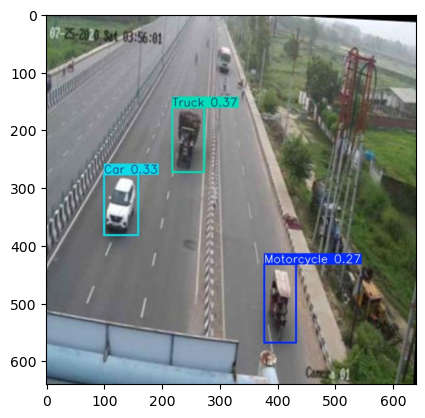

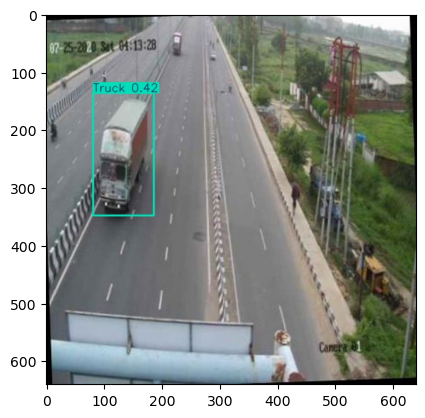

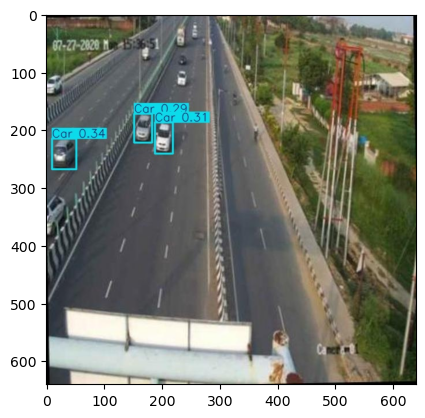

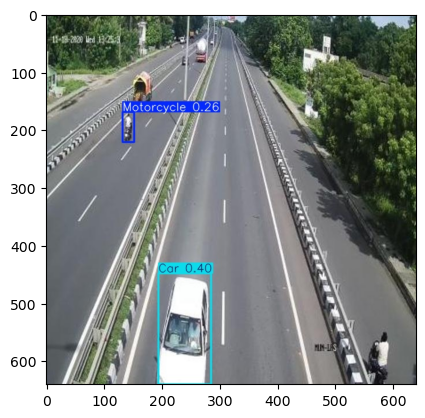

In [25]:
%matplotlib inline

predicitions = glob.glob(os.path.join('/kaggle/working/', 'runs/detect/predict', '*'))

n = 20

for i in range(n):
    idx = np.random.randint(0, len(predicitions))
    image = Image.open(predicitions[idx])
    plt.imshow(image)
    plt.grid(False)
    plt.show()

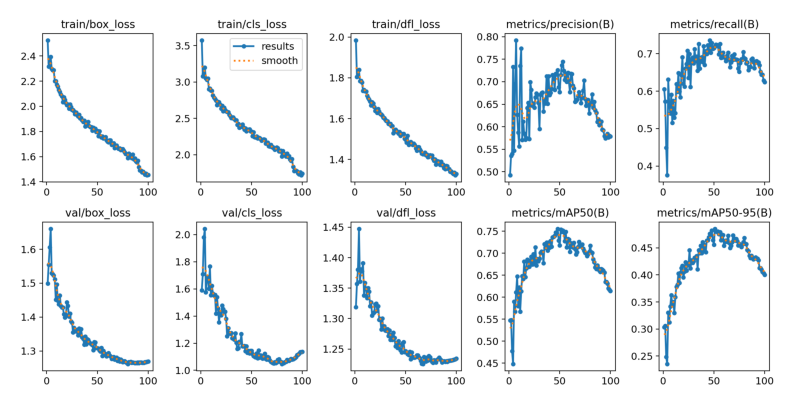

In [24]:
import matplotlib.pyplot as plt
import cv2
import os

# Muat dan tampilkan gambar
image = cv2.imread('/kaggle/working/runs/detect/yolov8m_v1_train/results.png')
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Ubah format dari BGR ke RGB untuk matplotlib

# Tampilkan gambar
plt.figure(figsize=(10, 8))
plt.imshow(image)
plt.axis('off')  # Matikan axis untuk tampilan lebih bersih
plt.show()